In [1]:
# might need to pip install yfinance
import yfinance as yf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import random
# !pip install kaggle

C:\Users\ynakadi\Anaconda3\lib\site-packages\yfinance\base.py:48: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  _empty_series = pd.Series()


#### Get S&P 500 Stocks

In [2]:
!!kaggle datasets download -d andrewmvd/sp-500-stocks --force
#!!kaggle datasets download -d williecosta/russell-3000-stock-history

['Downloading sp-500-stocks.zip to C:\\Users\\ynakadi\\Documents\\GitHub\\AlgorithmicTrading',
 '',
 '  0%|          | 0.00/42.6M [00:00<?, ?B/s]',
 '  5%|4         | 2.00M/42.6M [00:00<00:03, 13.9MB/s]',
 ' 12%|#1        | 5.00M/42.6M [00:00<00:02, 18.2MB/s]',
 ' 19%|#8        | 8.00M/42.6M [00:00<00:01, 20.0MB/s]',
 ' 26%|##5       | 11.0M/42.6M [00:00<00:01, 20.8MB/s]',
 ' 31%|###       | 13.0M/42.6M [00:00<00:01, 19.5MB/s]',
 ' 38%|###7      | 16.0M/42.6M [00:00<00:01, 21.2MB/s]',
 ' 45%|####4     | 19.0M/42.6M [00:00<00:01, 21.6MB/s]',
 ' 52%|#####1    | 22.0M/42.6M [00:01<00:00, 21.8MB/s]',
 ' 59%|#####8    | 25.0M/42.6M [00:01<00:00, 20.4MB/s]',
 ' 66%|######5   | 28.0M/42.6M [00:01<00:00, 20.9MB/s]',
 ' 73%|#######2  | 31.0M/42.6M [00:01<00:00, 21.3MB/s]',
 ' 80%|#######9  | 34.0M/42.6M [00:01<00:00, 20.9MB/s]',
 ' 87%|########6 | 37.0M/42.6M [00:01<00:00, 19.4MB/s]',
 ' 96%|#########6| 41.0M/42.6M [00:02<00:00, 21.6MB/s]',
 '100%|##########| 42.6M/42.6M [00:02<00:00, 20.8MB/s]

In [3]:
import zipfile
file = 'sp-500-stocks.zip'
print('Unzipping:',file)

with zipfile.ZipFile(file, 'r') as zip_ref:
    zip_ref.extractall()

Unzipping: sp-500-stocks.zip


In [4]:
# file = 'russell-3000-stock-history.zip'
# print('Unzipping:',file)

# with zipfile.ZipFile(file, 'r') as zip_ref:
#     zip_ref.extractall()

In [5]:
sp500_df = pd.read_csv('sp500_companies.csv')
sp500_df.head(5)

,Exchange,Symbol,Shortname,Longname,Sector,Industry,Currentprice,Marketcap,Ebitda,Revenuegrowth,City,State,Country,Fulltimeemployees,Longbusinesssummary,Weight
0,NMS,MSFT,Microsoft Corporation,Microsoft Corporation,Technology,Software - Infrastructure,404.06,3002343620608,1.184270e+11,0.176,Redmond,WA,United States,221000.0,Microsoft Corporation develops and supports so...,0.064672
1,NMS,AAPL,Apple Inc.,Apple Inc.,Technology,Consumer Electronics,182.31,2815212650496,1.301090e+11,0.021,Cupertino,CA,United States,161000.0,"Apple Inc. designs, manufactures, and markets ...",0.060641
2,NMS,NVDA,NVIDIA Corporation,NVIDIA Corporation,Technology,Semiconductors,726.13,1793541144576,2.216100e+10,2.055,Santa Clara,CA,United States,26196.0,"NVIDIA Corporation provides graphics, and comp...",0.038634
3,NMS,AMZN,"Amazon.com, Inc.","Amazon.com, Inc.",Consumer Cyclical,Internet Retail,169.51,1760768032768,8.551500e+10,0.139,Seattle,WA,United States,1525000.0,"Amazon.com, Inc. engages in the retail sale of...",0.037928
4,NMS,GOOGL,Alphabet Inc.,Alphabet Inc.,Communication Services,Internet Content & Information,140.52,1754293862400,1.001720e+11,0.135,Mountain View,CA,United States,182502.0,Alphabet Inc. offers various products and plat...,0.037788


In [6]:
# russell3000_df = pd.read_csv('prices.csv')
# russell3000_df.head(5)

In [7]:
#stocks_list = list(set(list(set(russell3000_df['symbol'])) + list(set(sp500_df['Symbol']))))
stocks_list = list(set(sp500_df['Symbol'])) 

In [8]:
start_date = "2016-01-01"
end_date = "2024-03-01"
stocks_df = pd.DataFrame()
random.shuffle(stocks_list)
for stock in stocks_list[:16]:
    df = yf.download(stock, start = start_date, end = end_date)
    df['company'] = stock
    stocks_df = pd.concat([stocks_df,df])
    
# Alternatively, you can do yf.download([stocks], start = start_date, end = end_date),
# but that leads to multi-index columns

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******

In [9]:
stocks_df

,Open,High,Low,Close,Adj Close,Volume,company
Date,,,,,,,
2016-01-04,52.970001,52.970001,51.700001,52.209999,47.143044,1350700,RMD
2016-01-05,52.209999,53.020000,52.209999,52.439999,47.350716,651200,RMD
2016-01-06,51.669998,51.889999,51.090000,51.400002,46.411648,1274900,RMD
2016-01-07,50.810001,52.020000,50.770000,51.860001,46.827011,1364900,RMD
2016-01-08,52.139999,52.599998,51.919998,52.119999,47.061775,1204500,RMD
...,...,...,...,...,...,...,...
2024-02-12,83.580002,83.610001,82.750000,83.099998,83.099998,1375200,ACGL
2024-02-13,83.330002,84.449997,83.120003,84.059998,84.059998,1586100,ACGL
2024-02-14,84.000000,85.370003,83.910004,84.870003,84.870003,2336100,ACGL


In [10]:
stocks_df.describe()

,Open,High,Low,Close,Adj Close,Volume
count,31661.000000,31661.000000,31661.000000,31661.000000,31661.000000,3.166100e+04
mean,91.777552,92.822439,90.719200,91.795076,86.989967,4.161034e+06
std,90.895700,91.960241,89.801252,90.910048,89.529782,4.617912e+06
min,4.698000,4.808000,4.632000,4.766000,4.766000,3.600000e+03
25%,46.090000,46.660000,45.439999,46.054001,40.840000,1.232400e+06
50%,62.240002,62.869999,61.509998,62.209999,56.790134,2.441900e+06
75%,90.269997,91.330002,89.389999,90.330002,87.750000,5.870100e+06
max,675.659973,679.849976,662.140015,675.150024,659.688293,1.668530e+08


In [11]:
close_price_df = stocks_df.loc[:,['Close','company']].reset_index()
close_price_df

,Date,Close,company
0,2016-01-04,52.209999,RMD
1,2016-01-05,52.439999,RMD
2,2016-01-06,51.400002,RMD
3,2016-01-07,51.860001,RMD
4,2016-01-08,52.119999,RMD
...,...,...,...
31656,2024-02-12,83.099998,ACGL
31657,2024-02-13,84.059998,ACGL
31658,2024-02-14,84.870003,ACGL
31659,2024-02-15,87.400002,ACGL


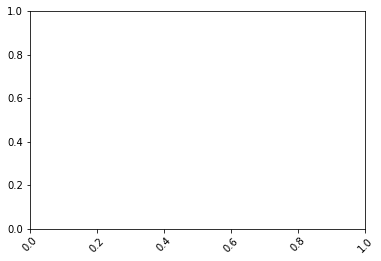

In [12]:
plt.xticks(rotation=45)
from matplotlib import rcParams

# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27
px.line(close_price_df,x='Date',y='Close',color='company').update_layout(
    xaxis_title="Date", yaxis_title="Close Price ($)"
)

### Aggregate for Industry + Sector

In [13]:
industry_df = stocks_df.reset_index().merge(sp500_df[['Symbol','Sector','Industry']],left_on='company',right_on='Symbol').set_index('Date')
industry_df

,Open,High,Low,Close,Adj Close,Volume,company,Symbol,Sector,Industry
Date,,,,,,,,,,
2016-01-04,52.970001,52.970001,51.700001,52.209999,47.143044,1350700,RMD,RMD,Healthcare,Medical Instruments & Supplies
2016-01-05,52.209999,53.020000,52.209999,52.439999,47.350716,651200,RMD,RMD,Healthcare,Medical Instruments & Supplies
2016-01-06,51.669998,51.889999,51.090000,51.400002,46.411648,1274900,RMD,RMD,Healthcare,Medical Instruments & Supplies
2016-01-07,50.810001,52.020000,50.770000,51.860001,46.827011,1364900,RMD,RMD,Healthcare,Medical Instruments & Supplies
2016-01-08,52.139999,52.599998,51.919998,52.119999,47.061775,1204500,RMD,RMD,Healthcare,Medical Instruments & Supplies
...,...,...,...,...,...,...,...,...,...,...
2024-02-12,83.580002,83.610001,82.750000,83.099998,83.099998,1375200,ACGL,ACGL,Financial Services,Insurance - Diversified
2024-02-13,83.330002,84.449997,83.120003,84.059998,84.059998,1586100,ACGL,ACGL,Financial Services,Insurance - Diversified
2024-02-14,84.000000,85.370003,83.910004,84.870003,84.870003,2336100,ACGL,ACGL,Financial Services,Insurance - Diversified


In [14]:
close_price_industry_df = industry_df.loc[:,['Close','Volume','Industry']].reset_index()
close_price_industry_df['Total'] = close_price_industry_df['Close'] * close_price_industry_df['Volume']
close_price_industry_df = close_price_industry_df.groupby(by=['Date','Industry']).sum().reset_index()
close_price_industry_df['mean_price']  = close_price_industry_df['Total']  / close_price_industry_df['Volume']
close_price_industry_df = close_price_industry_df[['Date','Industry','mean_price']]
close_price_industry_df
# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27
px.line(close_price_industry_df,x='Date',y='mean_price',color='Industry').update_layout(
    xaxis_title="Date", yaxis_title="Close Price (Averaged for Industry)"
)

In [15]:
close_price_sector_df = industry_df.loc[:,['Close','Volume','Sector']].reset_index()
close_price_sector_df['Total'] = close_price_sector_df['Close'] * close_price_sector_df['Volume']
close_price_sector_df = close_price_sector_df.groupby(by=['Date','Sector']).sum().reset_index()
close_price_sector_df['Close']  = close_price_sector_df['Total']  / close_price_sector_df['Volume']
close_price_sector_df = close_price_sector_df[['Date','Sector','Close']]
close_price_sector_df

,Date,Sector,Close
0,2016-01-04,Consumer Cyclical,41.445405
1,2016-01-04,Energy,51.240002
2,2016-01-04,Financial Services,32.554367
3,2016-01-04,Healthcare,101.759835
4,2016-01-04,Industrials,27.799999
...,...,...,...
16355,2024-02-16,Healthcare,94.158367
16356,2024-02-16,Industrials,82.525824
16357,2024-02-16,Real Estate,52.330002
16358,2024-02-16,Technology,161.281448


In [16]:
# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27
px.line(close_price_sector_df,x='Date',y='Close',color='Sector').update_layout(
    xaxis_title="Date", yaxis_title="Close Price (Averaged for Sector)"
)

In [17]:
industry_df

,Open,High,Low,Close,Adj Close,Volume,company,Symbol,Sector,Industry
Date,,,,,,,,,,
2016-01-04,52.970001,52.970001,51.700001,52.209999,47.143044,1350700,RMD,RMD,Healthcare,Medical Instruments & Supplies
2016-01-05,52.209999,53.020000,52.209999,52.439999,47.350716,651200,RMD,RMD,Healthcare,Medical Instruments & Supplies
2016-01-06,51.669998,51.889999,51.090000,51.400002,46.411648,1274900,RMD,RMD,Healthcare,Medical Instruments & Supplies
2016-01-07,50.810001,52.020000,50.770000,51.860001,46.827011,1364900,RMD,RMD,Healthcare,Medical Instruments & Supplies
2016-01-08,52.139999,52.599998,51.919998,52.119999,47.061775,1204500,RMD,RMD,Healthcare,Medical Instruments & Supplies
...,...,...,...,...,...,...,...,...,...,...
2024-02-12,83.580002,83.610001,82.750000,83.099998,83.099998,1375200,ACGL,ACGL,Financial Services,Insurance - Diversified
2024-02-13,83.330002,84.449997,83.120003,84.059998,84.059998,1586100,ACGL,ACGL,Financial Services,Insurance - Diversified
2024-02-14,84.000000,85.370003,83.910004,84.870003,84.870003,2336100,ACGL,ACGL,Financial Services,Insurance - Diversified


In [18]:
for sector in set(close_price_sector_df['Sector']):
    sector_df = close_price_sector_df[close_price_sector_df['Sector'] == sector]
    stock_df = industry_df[industry_df['Sector'] == sector].reset_index()[['Date','Close','Symbol']]
    stock_df = stock_df.rename(columns = {'Symbol':'Sector'})
    merge_df = pd.concat([stock_df,sector_df])
    rcParams['figure.figsize'] = 11.7,8.27
    fig = px.line(merge_df,x='Date',y='Close',color='Sector').update_layout(
        xaxis_title="Date", yaxis_title="Close Price (Averaged for Sector)"
    )
    fig.show()
    

## Normalization

In [19]:
close_price_pivot_df = close_price_df.pivot(index='Date',columns='company',values='Close')
close_price_norm_df = close_price_pivot_df.div(close_price_pivot_df.iloc[0]).mul(100)
close_price_norm_df = close_price_norm_df.stack().reset_index().rename(columns={0:'Close'})

In [20]:
# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27
px.line(close_price_norm_df,x='Date',y='Close',color='company').update_layout(
    xaxis_title="Date", yaxis_title="Close Price (Normalized)"
)

### Delete Function

In [21]:
# del (...) 

### Pct Change (for Pandas)

#### Daily Change

In [22]:
close_price_shift_df = close_price_pivot_df.shift(periods=1)
close_price_shift_df = close_price_shift_df.stack().reset_index().rename(columns={0:'Close'})

In [23]:
close_price_day_change_df = close_price_shift_df.merge(close_price_df, on = ['Date','company'])
close_price_day_change_df['pct_change'] = 100*(close_price_day_change_df.Close_y - close_price_day_change_df.Close_x) / close_price_day_change_df.Close_x
close_price_day_change_df

,Date,company,Close_x,Close_y,pct_change
0,2016-01-05,ACGL,22.950001,23.033333,0.363103
1,2016-01-05,AKAM,52.310001,52.020000,-0.554389
2,2016-01-05,AMAT,18.469999,18.490000,0.108286
3,2016-01-05,BALL,36.055000,36.480000,1.178753
4,2016-01-05,BDX,144.341461,144.800003,0.317679
...,...,...,...,...,...
31640,2024-02-16,MS,85.669998,86.500000,0.968836
31641,2024-02-16,MSCI,575.719971,568.750000,-1.210653
31642,2024-02-16,O,52.020000,52.330002,0.595927
31643,2024-02-16,OTIS,92.220001,91.239998,-1.062680


In [24]:
# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27
px.line(close_price_day_change_df,x='Date',y='pct_change',color='company').update_layout(
    xaxis_title="Date", yaxis_title="DoD Change in Stock Price"
)

#### Weekly Change

In [25]:
close_price_shift_df = close_price_pivot_df.shift(periods=7)
close_price_shift_df = close_price_shift_df.stack().reset_index().rename(columns={0:'Close'})

In [26]:
close_price_week_change_df = close_price_shift_df.merge(close_price_df, on = ['Date','company'])
close_price_week_change_df['pct_change'] = 100*(close_price_week_change_df.Close_y - close_price_week_change_df.Close_x) / close_price_week_change_df.Close_x
close_price_week_change_df

,Date,company,Close_x,Close_y,pct_change
0,2016-01-13,ACGL,22.950001,22.299999,-2.832251
1,2016-01-13,AKAM,52.310001,45.820000,-12.406808
2,2016-01-13,AMAT,18.469999,16.200001,-12.290193
3,2016-01-13,BALL,36.055000,34.320000,-4.812094
4,2016-01-13,BDX,144.341461,137.931702,-4.440692
...,...,...,...,...,...
31544,2024-02-16,MS,86.000000,86.500000,0.581395
31545,2024-02-16,MSCI,590.630005,568.750000,-3.704520
31546,2024-02-16,O,53.360001,52.330002,-1.930283
31547,2024-02-16,OTIS,91.769997,91.239998,-0.577529


In [27]:
# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27
px.line(close_price_week_change_df,x='Date',y='pct_change',color='company').update_layout(
    xaxis_title="Date", yaxis_title="WoW Change in Stock Price"
)

#### Monthly Change

In [28]:
close_price_shift_df = close_price_pivot_df.shift(periods=30)
close_price_shift_df = close_price_shift_df.stack().reset_index().rename(columns={0:'Close'})

In [29]:
close_price_month_change_df = close_price_shift_df.merge(close_price_df, on = ['Date','company'])
close_price_month_change_df['pct_change'] = 100*(close_price_month_change_df.Close_y - close_price_month_change_df.Close_x) / close_price_month_change_df.Close_x
close_price_month_change_df

,Date,company,Close_x,Close_y,pct_change
0,2016-02-17,ACGL,22.950001,22.730000,-0.958611
1,2016-02-17,AKAM,52.310001,53.419998,2.121959
2,2016-02-17,AMAT,18.469999,17.139999,-7.200866
3,2016-02-17,BALL,36.055000,33.560001,-6.919980
4,2016-02-17,BDX,144.341461,140.595123,-2.595469
...,...,...,...,...,...
31176,2024-02-16,MS,92.150002,86.500000,-6.131309
31177,2024-02-16,MSCI,559.719971,568.750000,1.613312
31178,2024-02-16,O,57.689999,52.330002,-9.291033
31179,2024-02-16,OTIS,87.680000,91.239998,4.060216


In [30]:
# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27
px.line(close_price_month_change_df,x='Date',y='pct_change',color='company').update_layout(
    xaxis_title="Date", yaxis_title="MoM Change in Stock Price"
)

#### Yearly Change

In [31]:
close_price_shift_df = close_price_pivot_df.shift(periods=365)
close_price_shift_df = close_price_shift_df.stack().reset_index().rename(columns={0:'Close'})

In [32]:
close_price_year_change_df = close_price_shift_df.merge(close_price_df, on = ['Date','company'])
close_price_year_change_df['pct_change'] = 100*(close_price_year_change_df.Close_y - close_price_year_change_df.Close_x) / close_price_year_change_df.Close_x
close_price_year_change_df

,Date,company,Close_x,Close_y,pct_change
0,2017-06-15,ACGL,22.950001,31.436666,36.978934
1,2017-06-15,AKAM,52.310001,49.189999,-5.964448
2,2017-06-15,AMAT,18.469999,43.160000,133.676240
3,2017-06-15,BALL,36.055000,41.150002,14.131192
4,2017-06-15,BDX,144.341461,187.170731,29.672188
...,...,...,...,...,...
25816,2024-02-16,MS,86.400002,86.500000,0.115739
25817,2024-02-16,MSCI,451.950012,568.750000,25.843563
25818,2024-02-16,O,67.690002,52.330002,-22.691683
25819,2024-02-16,OTIS,71.720001,91.239998,27.216950


In [33]:
# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27
px.line(close_price_year_change_df,x='Date',y='pct_change',color='company').update_layout(
    xaxis_title="Date", yaxis_title="YoY Change in Stock Price"
)

### Specific Sample of Data

In [34]:
# Last Day of Month
close_price_df.set_index("Date").resample("M").last()

# Last Business Day
close_price_df.set_index("Date").resample("BM").last()

,Close,company
Date,,
2016-01-29,22.516666,ACGL
2016-02-29,22.646667,ACGL
2016-03-31,23.700001,ACGL
2016-04-29,23.496668,ACGL
2016-05-31,24.219999,ACGL
...,...,...
2023-10-31,86.680000,ACGL
2023-11-30,83.690002,ACGL
2023-12-29,74.269997,ACGL


### Histogram

<Axes: >

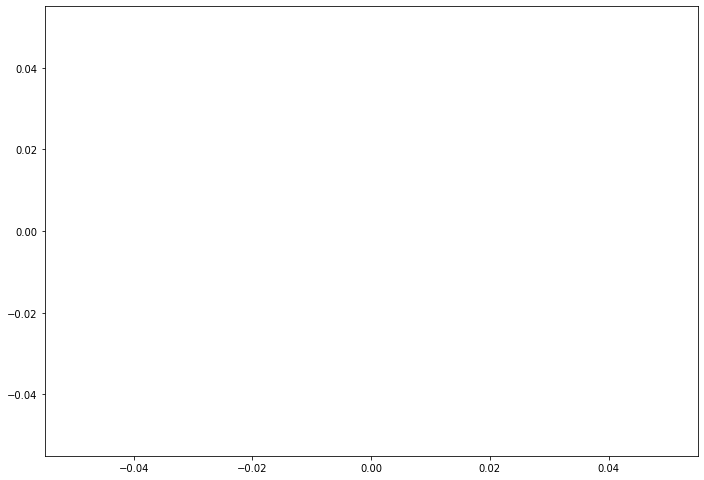

In [35]:
company = 'LLY'
pct_change_vals = close_price_day_change_df[close_price_day_change_df['company'] == company]['pct_change']
sns.histplot(pct_change_vals,bins=100)

In [36]:
print(np.mean(pct_change_vals))
print(np.std(pct_change_vals))
print(np.var(pct_change_vals))

nan
nan
nan


In [37]:
company_comp_df = close_price_day_change_df[['company','pct_change']].groupby(by='company').agg({'pct_change':['mean','std']})

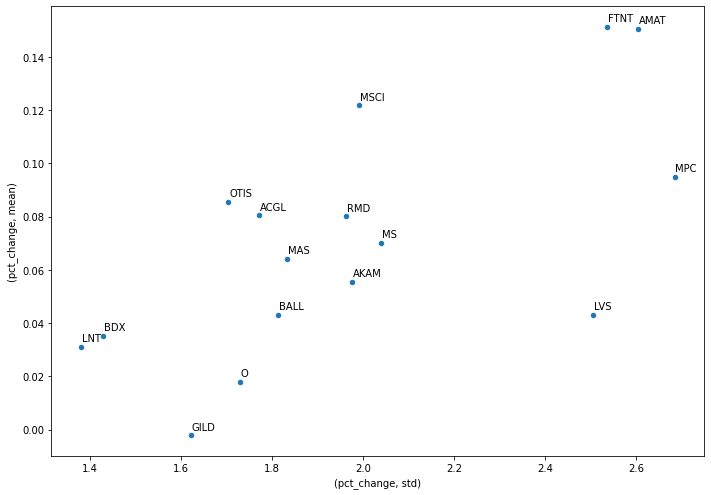

In [38]:
company_comp_df.plot.scatter(x=('pct_change','std'),y=('pct_change','mean'))
for i in company_comp_df.index:
    plt.annotate(i, xy= (company_comp_df.loc[i,('pct_change','std')]+2e-3, company_comp_df.loc[i,('pct_change','mean')]+2e-3))

### Correlation + Covariance

In [39]:
close_price_day_comp_df = close_price_day_change_df[['Date','company','pct_change']].pivot(index='Date',columns='company',values='pct_change')

#### Covariance

In [40]:
close_price_day_comp_df.cov()

company,ACGL,AKAM,AMAT,BALL,BDX,FTNT,GILD,LNT,LVS,MAS,MPC,MS,MSCI,O,OTIS,RMD
company,,,,,,,,,,,,,,,,
ACGL,3.140381,0.735013,1.754335,1.157060,0.792460,1.172302,0.772787,1.069904,1.673499,1.338968,2.400386,2.019704,1.378339,1.448768,1.514638,1.139120
AKAM,0.735013,3.899549,1.769863,1.025849,0.864135,1.856099,0.972789,0.578344,1.046568,1.225841,0.989645,1.311432,1.516165,0.394068,0.809321,1.287867
AMAT,1.754335,1.769863,6.784834,1.649367,1.161326,3.088867,1.122827,0.785042,2.918674,2.364334,2.731290,2.823453,2.799327,1.423113,1.764511,2.113137
BALL,1.157060,1.025849,1.649367,3.289351,0.764129,1.415046,0.794683,1.029020,1.007793,1.419570,1.089945,1.398554,1.412782,1.007576,1.322348,1.313403
BDX,0.792460,0.864135,1.161326,0.764129,2.038238,0.885703,0.731125,0.754778,0.700879,0.901930,0.969398,0.996417,1.163684,0.665081,0.674784,1.156954
FTNT,1.172302,1.856099,3.088867,1.415046,0.885703,6.427267,0.799191,0.514612,1.794847,1.661928,1.805744,1.885482,2.702297,1.052342,1.429194,1.871062
GILD,0.772787,0.972789,1.122827,0.794683,0.731125,0.799191,2.629658,0.562192,0.693830,0.787648,0.830332,1.025027,0.818019,0.446825,0.690923,0.786511
LNT,1.069904,0.578344,0.785042,1.029020,0.754778,0.514612,0.562192,1.904986,0.453535,0.890476,0.890595,0.752649,0.878245,1.318999,0.920366,0.980355
LVS,1.673499,1.046568,2.918674,1.007793,0.700879,1.794847,0.693830,0.453535,6.274648,1.631590,2.877555,2.541432,1.722853,1.345560,1.448104,1.082534


#### Correlation

In [41]:
close_price_day_comp_df.corr()

company,ACGL,AKAM,AMAT,BALL,BDX,FTNT,GILD,LNT,LVS,MAS,MPC,MS,MSCI,O,OTIS,RMD
company,,,,,,,,,,,,,,,,
ACGL,1.000000,0.210037,0.380060,0.360006,0.313226,0.260937,0.268917,0.437429,0.376998,0.412378,0.504659,0.558652,0.390749,0.472958,0.429482,0.327616
AKAM,0.210037,1.000000,0.344083,0.286432,0.306512,0.370750,0.303782,0.212194,0.211576,0.338800,0.186716,0.325524,0.385720,0.115446,0.268920,0.332392
AMAT,0.380060,0.344083,1.000000,0.349134,0.312289,0.467753,0.265824,0.218362,0.447323,0.495399,0.390667,0.531320,0.539904,0.316071,0.369158,0.413471
BALL,0.360006,0.286432,0.349134,1.000000,0.295110,0.307753,0.270203,0.411076,0.221831,0.427187,0.223902,0.377980,0.391339,0.321394,0.367079,0.369088
BDX,0.313226,0.306512,0.312289,0.295110,1.000000,0.244708,0.315802,0.383042,0.195984,0.344796,0.252978,0.342105,0.409487,0.269502,0.270497,0.413024
FTNT,0.260937,0.370750,0.467753,0.307753,0.244708,1.000000,0.194396,0.147069,0.282631,0.357780,0.265370,0.364548,0.535492,0.240137,0.293873,0.376151
GILD,0.268917,0.303782,0.265824,0.270203,0.315802,0.194396,1.000000,0.251183,0.170808,0.265093,0.190770,0.309835,0.253423,0.159405,0.257060,0.247196
LNT,0.437429,0.212194,0.218362,0.411076,0.383042,0.147069,0.251183,1.000000,0.131181,0.352121,0.240405,0.267295,0.319671,0.552858,0.349272,0.362013
LVS,0.376998,0.211576,0.447323,0.221831,0.195984,0.282631,0.170808,0.131181,1.000000,0.355494,0.427994,0.497312,0.345530,0.310759,0.294097,0.220259


<Axes: xlabel='company', ylabel='company'>

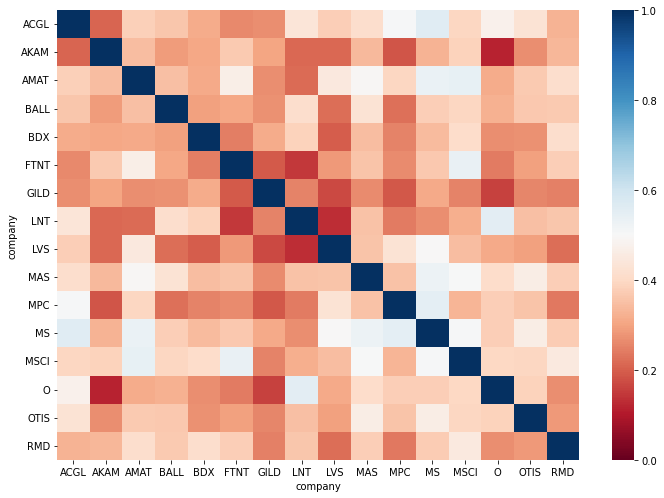

In [42]:
sns.heatmap(close_price_day_comp_df.corr(),cmap = 'RdBu',vmin = 0, vmax = 1)

## Simple returns and log returns

In [43]:
# Simple returns can be misleading
# Log returns is muchhhh more accurate

In [44]:
stocks_df[['Close','company']]

,Close,company
Date,,
2016-01-04,52.209999,RMD
2016-01-05,52.439999,RMD
2016-01-06,51.400002,RMD
2016-01-07,51.860001,RMD
2016-01-08,52.119999,RMD
...,...,...
2024-02-12,83.099998,ACGL
2024-02-13,84.059998,ACGL
2024-02-14,84.870003,ACGL


In [45]:
# Forward fill fillna(method = 'ffill')
# Backward fill fillna(method = 'bfill')

## Cumulative Returns + Drawdowns

In [46]:
# Cumulative Max (cummax)
# Cumulative Sum (cumsum)


4
BALL
2023-10-23 00:00:00


FTNT
2023-11-07 00:00:00


ACGL
2020-05-13 00:00:00


MS
2020-03-23 00:00:00


RMD
2023-10-27 00:00:00


AKAM
2023-03-13 00:00:00


O
2020-03-18 00:00:00


GILD
2020-12-30 00:00:00


LNT
2020-03-23 00:00:00


MPC
2020-03-23 00:00:00


AMAT
2022-10-17 00:00:00


MSCI
2022-05-09 00:00:00


OTIS
2022-09-30 00:00:00


MAS
2020-03-23 00:00:00


BDX
2020-03-23 00:00:00


LVS
2022-05-12 00:00:00




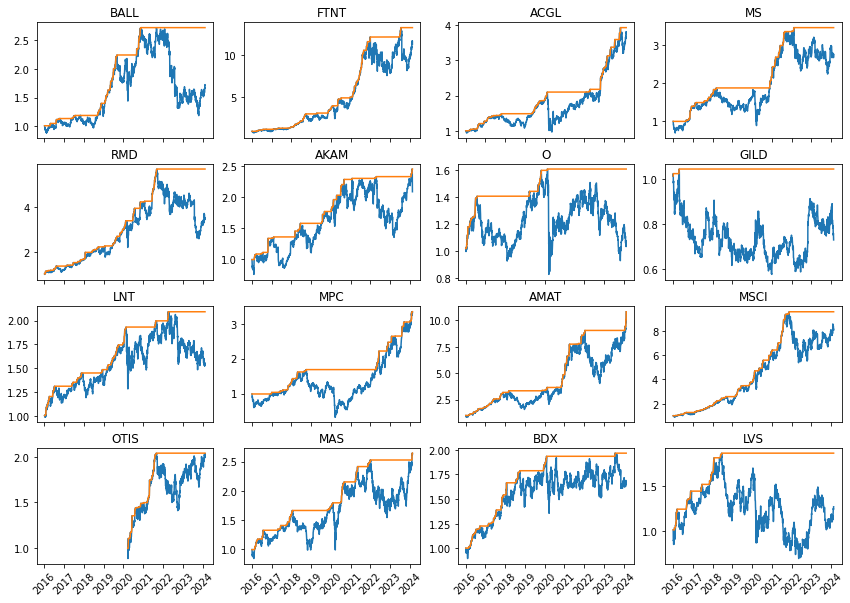

<Figure size 5760x5760 with 0 Axes>

In [47]:
companies = list(set(stocks_df['company']))
size = int(np.sqrt(len(companies)))
print(size)
fig, axs = plt.subplots(size,size,sharex=True,layout='constrained')
plt.figure(figsize=(80,80))
for i in range(len(companies)):
    x = i // size
    y = i % size
    company = companies[i]
    returns_df = stocks_df[stocks_df['company']==company][['Close']]
    returns_df['d_returns'] = np.log(returns_df[['Close']].div(returns_df[['Close']].shift(1)))
    returns_df['cum_returns'] = returns_df.d_returns.cumsum().apply(np.exp)
    returns_df['cum_max'] = returns_df.cum_returns.cummax()
    returns_df['Drawdown_Percentage'] = (returns_df['cum_max'] - returns_df['cum_returns']) / returns_df['cum_max']
    print(company)
    print(returns_df.Drawdown_Percentage.idxmax())
    print('\n')
    axs[x,y].plot(returns_df[['cum_returns','cum_max']])
    axs[x,y].tick_params(axis='x', rotation=45)
    axs[x,y].title.set_text(str(company)) 


## Backtesting

In [48]:
RTX_df = stocks_df[stocks_df['company']=='TSLA'][['Close']]

In [49]:
# Moving average [mean + median]
num_days = 50
RTX_roll = RTX_df.rolling(window=num_days)
RTX_roll_mean = RTX_roll.mean()
RTX_roll_median = RTX_roll.median()

<Axes: xlabel='Date'>

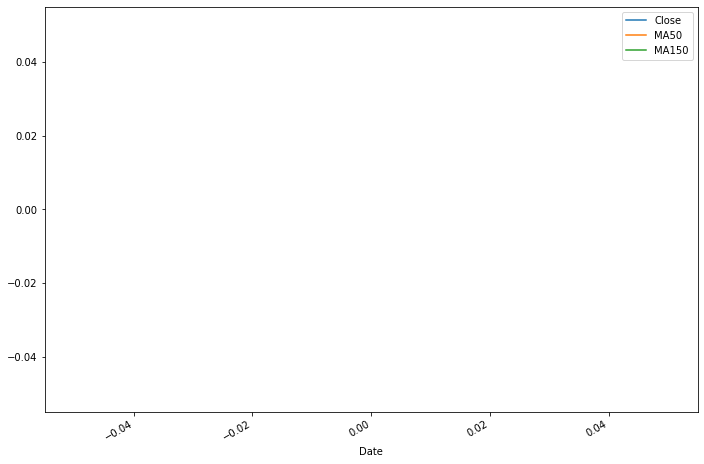

In [50]:
RTX_df['MA50'] = RTX_df[['Close']].rolling(window=num_days).mean()
RTX_df['MA150'] = RTX_df[['Close']].rolling(window=num_days*3).mean()

RTX_df.plot()

<Axes: xlabel='Date'>

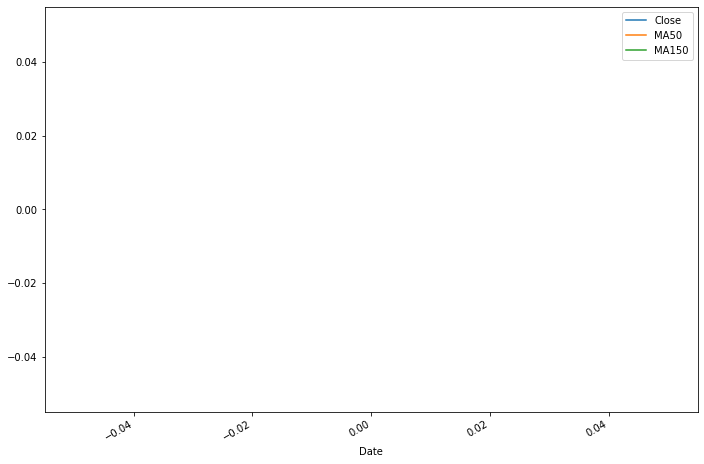

In [51]:
RTX_df.dropna(inplace=True)
RTX_df.plot()

In [52]:
# Short bias
RTX_df['position_short'] = np.where(RTX_df['MA50'] < RTX_df['MA150'],1,-1)

# Long bias
RTX_df['position_long'] = np.where(RTX_df['MA50'] > RTX_df['MA150'],1,-1)

<Axes: xlabel='Date'>

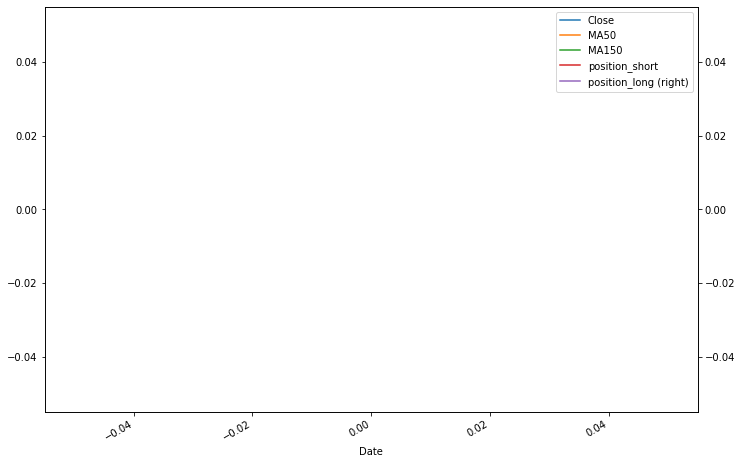

In [53]:
RTX_df.plot(secondary_y='position_long')

In [54]:
RTX_df['returnsb&h'] = np.log(RTX_df[['Close']].div(RTX_df[['Close']].shift(1)))
RTX_df['strategy_long'] = RTX_df['returnsb&h'] * RTX_df['position_long'].shift(1)
RTX_df['strategy_short'] = RTX_df['returnsb&h'] * RTX_df['position_short'].shift(1)

### Compare

In [55]:
print(RTX_df[['returnsb&h','strategy_long','strategy_short']].sum())
print(RTX_df[['returnsb&h','strategy_long','strategy_short']].std()*np.sqrt(252))

returnsb&h        0.0
strategy_long     0.0
strategy_short    0.0
dtype: float64
returnsb&h       NaN
strategy_long    NaN
strategy_short   NaN
dtype: float64


In [56]:
RTX_df[['returnsb&h','strategy_long','strategy_short']].sum().apply(np.exp) # What 1 dollar is worth

returnsb&h        1.0
strategy_long     1.0
strategy_short    1.0
dtype: float64

## Function

In [57]:
def test_strategy(stock,SMA):
    df = stocks_df[stocks_df['company'] == stock]
    RTX_df= df.Close.to_frame()
    RTX_df['SMA_S'] = RTX_df[['Close']].rolling(window=int(SMA[0])).mean()
    RTX_df['SMA_L'] = RTX_df[['Close']].rolling(window=int(SMA[1])).mean()
    RTX_df['returnsb&h'] = np.log(RTX_df[['Close']].div(RTX_df[['Close']].shift(1)))
    RTX_df.dropna(inplace=True)
    # Short bias
    RTX_df['position_short'] = np.where(RTX_df['SMA_S'] < RTX_df['SMA_L'],1,-1)

    # Long bias
    RTX_df['position_long'] = np.where(RTX_df['SMA_S'] > RTX_df['SMA_L'],1,-1)
    
    RTX_df['strategy_long'] = RTX_df['returnsb&h'] * RTX_df['position_long'].shift(1)
    RTX_df['strategy_short'] = RTX_df['returnsb&h'] * RTX_df['position_short'].shift(1)
    
    long_returns = np.exp(RTX_df['strategy_long'].sum())
    long_std = RTX_df['strategy_long'].std() * np.sqrt(252)
    
    short_returns = np.exp(RTX_df['strategy_short'].sum())
    short_std = RTX_df['strategy_short'].std() * np.sqrt(252)
    
    return (long_returns, long_std), (short_returns,short_std)

In [58]:
test_strategy("SPY",(50,200))

((1.0, nan), (1.0, nan))

In [59]:
class SMA_Backtester():
    def __init__(self, stock, SMA_S, SMA_L):
        self.stock = stock
        self.SMA_S = SMA_S
        self.SMA_L = SMA_L
        self.results = None
        self.get_data()
        
    def get_data(self):
        df = stocks_df[stocks_df['company'] == self.stock]
        RTX_df= df.Close.to_frame()
        RTX_df['SMA_S'] = RTX_df[['Close']].rolling(window=int(self.SMA_S)).mean()
        RTX_df['SMA_L'] = RTX_df[['Close']].rolling(window=int(self.SMA_L)).mean()
        RTX_df['returns'] = np.log(RTX_df[['Close']].div(RTX_df[['Close']].shift(1)))
        RTX_df.dropna(inplace=True)
        self.data2 = RTX_df
        return RTX_df
    
    def test_results(self):
        # Short bias
        data = self.data2.copy().dropna()
        data['position_short'] = np.where(data['SMA_S'] < data['SMA_L'],1,-1)

        # Long bias
        data['position_long'] = np.where(data['SMA_S'] > data['SMA_L'],1,-1)

        data['strategy_long'] = data['returns'] * data['position_long'].shift(1)
        data['strategy_short'] = data['returns'] * data['position_short'].shift(1)
        
        data['returnsbh'] = data['returns'].cumsum().apply(np.exp)
        data['return_strategy_long'] = data['strategy_long'].cumsum().apply(np.exp)
        data['return_strategy_short'] = data['strategy_short'].cumsum().apply(np.exp)
        
        short_perf = data['return_strategy_short'].iloc[-1]
        long_perf = data['return_strategy_long'].iloc[-1]
        
        short_outperf = short_perf - data['returnsbh'].iloc[-1]
        long_outperf = long_perf - data['returnsbh'].iloc[-1]
        self.results = data
        
        #         long_returns = np.exp(data['strategy_long'].sum())
        #         long_std = data['strategy_long'].std() * np.sqrt(252)

        #         short_returns = np.exp(data['strategy_short'].sum())
        #         short_std = data['strategy_short'].std() * np.sqrt(252)
        return (round(short_perf,4),round(short_outperf,4)), (round(long_perf,4),round(long_outperf,4))
    
    def plot_results(self):
        if self.results is None:
            print("Run the Test")
        else:
            title = "{}| SMA_S={} | SMA_L={}".format(self.stock, self.SMA_S, self.SMA_L)
            self.results[['returnsbh','return_strategy_short','return_strategy_long']].plot(title = title, figsize = (20,15))



In [60]:
x = SMA_Backtester('NVO',50,200)

In [61]:
x.test_results()

IndexError: single positional indexer is out-of-bounds

In [ ]:
x.plot_results()

## API

In [ ]:
# !pip install alpha_vantage

In [ ]:
from alpha_vantage.timeseries import TimeSeries

In [ ]:
API_key = 'ZXQLHOI678WR78YB'

In [ ]:
ts = TimeSeries(key=API_key,output_format='pandas')

In [ ]:
data = ts.get_weekly('AAPL')
data[0]

## Weinstein Trading Strategy

In [ ]:
stocks_df

In [ ]:
df = stocks_df[stocks_df['company'] == 'GOOG']
spy_df = stocks_df[stocks_df['company'] == 'SPY']
df['SMA_S'] = df[['Close']].rolling(window=30*5).mean()
spy_df['SMA_S'] = spy_df[['Close']].rolling(window=30*5).mean()

df = df.dropna()#.reset_index()
spy_df = spy_df.dropna()#.reset_index()

# df['date_str'] = df['Date'].apply(lambda x: str(x))
# spy_df['date_str'] = spy_df['Date'].apply(lambda x: str(x))

fig, ax1 = plt.subplots(figsize=(12,6))
df[['Close']].plot(label='Daily Closing Price (Stock)',ax=ax1,color = 'violet')
df[['SMA_S']].plot(label='30 Week Moving Average (Stock)',ax=ax1,color = 'red')
spy_df[['SMA_S']].plot(label='30 Week Moving Average (SPY)',ax=ax1,color = 'green')
spy_df[['Close']].plot(label='Daily Closing Price (SPY)',ax=ax1,color = 'blue')

# sns.lineplot(spy_df, x="date_str", y="Close",label='Daily Closing Price (SPY)',ax=ax1,color = 'red')
# sns.lineplot(spy_df, x="date_str", y="SMA_S",label='30 Week Moving Average (SPY)', ax=ax1,color = 'green')
plt.legend(['Daily Closing Price (Stock)','30 Week Moving Average (Stock)', 'Daily Closing Price (SPY)','30 Week Moving Average (SPY)'])
plt.xticks(rotation=90)
# ax2 = ax1.twinx()

# sns.barplot(df, x="date_str", y="Volume",ax=ax2,color='mediumblue')



# ax2.set_ylabel("Share Price",color='mediumblue')
df

In [ ]:
sns.lineplot(df, x="Date", y="SMA_S",label='Daily Closing Price ($)')